In [2]:
import numpy as np
import scipy.io
import seaborn as sns

from matplotlib import animation
import matplotlib.pyplot as plt
import seaborn as sns # named from Samuel Norman "Sam" Seaborn is a fictional character portrayed by Rob Lowe on the television serial drama The West Wing.
import sys
import pandas as pd
import re
from datetime import datetime

directory = 'Data_210428/'
fs = [directory + f for f in os.listdir(directory)]
csv_files = [f for f in fs if '.csv' in f]
log_file = [f for f in fs if '.log' in f][0]

print(len(csv_files))

heading = 'time,red,beat_red,pulse_red,pulse_red_threshold,red_sig,ir_sig,r,i'

6


In [2]:
def add_newline_from_date(file):
    with open(file, 'r') as f:
        data = f.read()
        print(len(data))

        a = [m.start(0) for m in re.finditer('16183\d{5}.', data)]
        out_data = ''

        for i,j in zip(a[1:], a[:-1]):
            out_data = f'{out_data}\n{data[j:i]}'
        
    with open(file, 'w') as o:
        o.write()
        o.write(out_data)

def remove_bad_lines(file):
    name = file.split('.')
    
    count = heading.count(',')

    with open(file, 'r') as f, open(f'{name[0]}_2.{name[1]}', 'w') as o:
        skip_next = False
        for l in f:
            if l.count(',') == count:
                if ',' not in l[-2:]:
                    if not skip_next:
                        o.write(l)
                    else:
                        skip_next = False
                else:
                    skip_next = True
                
#originals = [f for f in csv_files if '_2.csv' not in f]
#derivatives = [f for f in csv_files if '_2.csv' in f]
#print(originals, derivatives)
#for file in originals:
#    print(file)
#    remove_bad_lines(file)

In [3]:
log = []
with open(log_file) as f:
    for l in f:
        if 'alternate, ' in l or 'alternate single backstep, ' in l or 'vary_dutycycle, ' in l:
            log.append(l.strip())

log = [l.split('     ') for l in log]
log = [(l[0].split(' '), l[1]) for l in log]
log = [(f'{l[0][0]} {l[0][1]}', l[1]) for l in log]
log = [(datetime.strptime(l[0], '%Y-%m-%d %H:%M:%S'), l[1]) for l in log]

log = pd.DataFrame(log, columns=['time', 'action'])
log.head()

,time,action
0,2021-04-28 12:29:04,"alternate, 20, 0.1, 0.1, 1, 20"
1,2021-04-28 12:30:29,"alternate, 20, 0.1, 1, 1, 20"
2,2021-04-28 12:42:56,"alternate, -1, 0.1, 0.5, 1, -1"
3,2021-04-28 12:44:38,"alternate, -1, 0.1, 0.5, 1, -1"
4,2021-04-28 12:52:17,"alternate, -1, 0.1, 0.5, 1, -1"


In [4]:
dfs = [pd.read_csv(f) for f in csv_files]
df = pd.concat(dfs)
df['timestamp'] = pd.to_datetime(df['time'], unit='s')

Text(0, 0.5, 'Instensity')

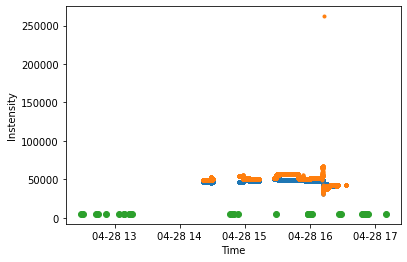

In [5]:
plt.plot(df['timestamp'], df['r'], '.')
plt.plot(df['timestamp'], df['i'], '.')
#plt.gcf().autofmt_xdate()

xs = log.iloc[:,0]
ys = np.ones(len(xs))*5000
#print(xs)
#print(ys)
plt.plot(xs, ys, 'o')

#plt.title(file)
plt.xlabel('Time')
plt.ylabel('Instensity')

#plt.figure()
#plt.plot(df['timestamp'], df['red'])
#plt.figure()
#plt.plot(df['timestamp'], df['beat_red'])
#plt.figure()
#plt.plot(df['timestamp'], df['red_sig'])
#plt.figure()
#plt.plot(df['timestamp'], df['ir_sig'])

In [6]:
def is_time_between(begin_time, end_time, check_time=None):
    # If check time is not given, default to current UTC time
    check_time = check_time or datetime.utcnow().time()
    if begin_time < end_time:
        return check_time >= begin_time and check_time <= end_time
    else: # crosses midnight
        return check_time >= begin_time or check_time <= end_time

output = []

# TODO: for each syringe-log interval, check if there are data-points in region. If so, plot that with title as the script given.
for index, row in log.iterrows():
    

    if index == len(log)-1:
        break # do not include last point in loop

    # print(index, row)
    start = log.iloc[index,0]
    end = log.iloc[index+1,0]

    for i, d in df.iterrows():
        if is_time_between(start, end, d['timestamp']):
            output.append(row)
            break
    #output += [d for d in df if is_time_between(start, end, d.['timestamp'])]

print(output)

[time                 2021-04-28 13:16:06
action    alternate, -1, 0.2, 0.5, 1, -1
Name: 10, dtype: object, time             2021-04-28 14:54:08
action    vary_dutycycle, 1, 1, 0, 1
Name: 14, dtype: object, time               2021-04-28 15:28:20
action    vary_dutycycle, 0.2, 1, 0, 1
Name: 15, dtype: object, time                 2021-04-28 15:58:03
action    alternate, 10, 0.1, 0.5, 1, 10
Name: 16, dtype: object, time                 2021-04-28 15:58:18
action    alternate, 10, 0.1, 0.5, 1, 10
Name: 17, dtype: object, time                 2021-04-28 15:58:37
action    alternate, 20, 0.1, 0.5, 1, 20
Name: 18, dtype: object, time                 2021-04-28 15:59:09
action    alternate, 20, 0.1, 0.5, 1, 20
Name: 19, dtype: object, time                 2021-04-28 15:59:57
action    alternate, 20, 0.1, 0.5, 1, 20
Name: 20, dtype: object, time                 2021-04-28 16:00:39
action    alternate, 40, 0.1, 0.5, 1, 40
Name: 21, dtype: object, time                 2021-04-28 16:02:12
action 

In [ ]:
for o in output:
    plt.figure()
    plt.plot(o.)

In [ ]:
import datetime
import time

def read_csv(file):
    return pd.read_csv(file)

def plot_csv(df):
    df['timestamp'] = pd.to_datetime(df['time'], unit='s')

    plt.plot(df['timestamp'], df['r'])
    plt.plot(df['timestamp'], df['i'])
    plt.gcf().autofmt_xdate()
    plt.xlabel('Time')
    plt.ylabel('Light Intensity (arb)')
    plt.title('Bath Oximeter Output')


fig, ax = plt.subplots(nrows=2, sharex=True)
plt.sca(ax[0])

A = [read_csv(file) for file in csv_files]

for a in A:
    plot_csv(a)
    
plt.sca(ax[1])

def so2(po2):
    a = float(po2**3+150*po2)
    if a == 0:
        return 0
    return (a**-1*23400+1)**-1 * 100

def load_mat(file):
    
    key = [k for k in mat.keys() if '__' not in k][0]
    data = mat[key]

    headings = data[0,:]
    headings = [str(h[0]) for h in headings]

    df = pd.DataFrame(data[1:,:], columns=headings)
    df = df.applymap(lambda x : np.array(x).flatten()[0])
    
    return df
    #mat = scipy.io.loadmat(file)
    #var = 'pO2data'
    #headings = ['Time', 'mmHg (Pre)', 'Temp. (Pre)', 'mmHg (Post)', 'Temp. (Post)']

    #if var in mat:
    #    print(var)
    #    mat = mat[var]
    #    headings = [a[0] for a in mat[0,:]]
    #    mat = mat[1:,:]

        #plt.plot(mat[:,1])
        #plt.plot(mat[:,2])
        #plt.plot(mat[:,3])
        #plt.plot(mat[:,4])

    #    ts = [datetime.datetime.strptime(f'2021-3-25 {t[0]}', '%Y-%m-%d %H:%M:%S:%f')     
    #for t in mat[:,0]]
    #    # ts = [time.mktime(t.timetuple()) for t in ts]
    #    return ts, mat, headings

def plot_mat(df, idx):
    
    #ts, mat, headings = b

    #a = [e[0][0] for e in mat[:,idx]]
    heading = list(df.columns)[idx]
    ts = df.iloc[:,0]
    a = df.iloc[:,idx]

    if 'mmHg' in heading:
        a = a.apply(lambda x: so2(x))
        heading = 'Blood oxygen'
        plt.ylabel('SO2 (%)')
    else:
        plt.ylabel('Temperature (C)')
    
    plt.plot(ts, a)
    plt.title(heading)
    plt.xlabel('Time')
    plt.gcf().autofmt_xdate()
    
#print(mat_files[0])

# Do not use probe 1, did not work propperly on the day
#for i, file in enumerate(mat_files):
#    load_mat(file, 1)
#plt.show()
#for i, file in enumerate(mat_files):
#    load_mat(file, 2)
#plt.show()

# Probe 2
B = [load_mat(file) for file in mat_files]

for b in B:
    plot_mat(b, 3)
plt.show()

for b in B:
    plot_mat(b, 4)
plt.show()

    #print(mat)
    #plt.plot(mat['time'], mat['r'])
    #plt.plot(mat['time'], mat['i'])

In [ ]:
fig, ax = plt.subplots(nrows=2, sharex=True)
plt.sca(ax[0])
plot_csv(A[1])
plt.sca(ax[1])
plot_mat(B[1], 3)

In [ ]:

def sync_vectors(t1, v1, t2, v2):
    # synchronizes the data in v1 and v2 based on their time-stamps in t1 and t2

    i2 = 0 # index of 2

    for i1, t in enumerate(t1):
        while t >= t2[i2]:
            
            i2 += 1

def time_merge(t1, v1, t2, v2, dt=1):

    t1 = np.array(t1)
    v1 = np.array(v1)
    t2 = np.array(t2)
    v2 = np.array(v2)

    idx = 0

    r = np.zeros((t1.shape[0], 3))

    for t, a in zip(t1, v1):
        close = np.logical_and(t-dt < t2, t2 < t+dt)
        if any(close):
             r[idx,0] = t
             r[idx,1] = a
             r[idx,2] = np.mean(v2[close]) # compute mean of only elements within time span
             idx += 1

    return r[~np.all(r == 0, axis=1)] # Remove zero-rows

t1 = np.linspace(1,10,20)
t2 = np.linspace(4,15,20)
v1 = t1
v2 = t2

print(t1, v1, t2, v2)
print(time_merge(t1, v1, t2, v2, 1))

In [ ]:
t1 = pd.Series(A[1]['timestamp'])
v1 = pd.Series(A[1]['i'])
v11 = pd.Series(A[1]['r'])
t2 = pd.Series(B[1][0])
v2 = pd.Series([e[0][0] for e in B[1][1][:,3]])
v2 = pd.Series([so2(e) for e in v2])

from datetime import timedelta
delta = timedelta(seconds=1)

print(t1, t2)
print(t1[0])
print(t1[0]+delta)
r = time_merge(t1, v1, t2, v2, 1_000_000_000)
r2 = time_merge(t1, v11, t2, v2, 1_000_000_000)
r = np.vstack((r[:,0], r[:,1], r2[:,1], r[:,2])).T
print(r)

In [ ]:
fig, ax = plt.subplots(nrows=2, sharex=True)
plt.gcf().autofmt_xdate()
plt.sca(ax[0])
plt.plot(r[:,0], r[:,1])
plt.plot(r[:,0], r[:,2])
plt.sca(ax[1])
plt.plot(r[:,0], r[:,3])
plt.show()

plt.plot(r[:,3])
plt.show()
rg = range(22000,30000)
plt.plot(r[rg,3])
plt.show()
plt.figure()
sns.scatterplot(r[rg,1], r[rg,3])
sns.scatterplot(r[rg,2], r[rg,3])
plt.xlabel('Light intensity (arb)')
plt.ylabel('SO2 (%)')
plt.legend(('IR', 'RED'))

In [1]:
import mat4py

file = mat_files[0]
mat = scipy.io.loadmat(file)
#mat = mat4py.loadmat(file)
#df = pd.DataFrame(mat)


NameError: name 'mat_files' is not defined

y=0.168000x+(81.400000)


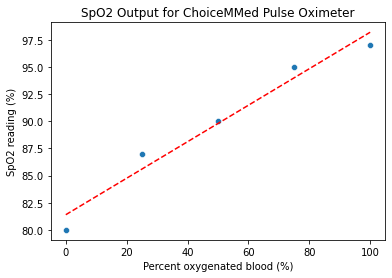